### VISUALIZATION PIPELINE for Celine

In [2]:
# ----------------------------------
# FUNCTIONS 
# ----------------------------------

from multidimvis_main import *

## INPUT 

In [3]:
# ----------------------------------
# GRAPH INPUT 
# ----------------------------------

# EXAMPLE: Y E A S T 
organism = 'Yeast'

data = pickle.load( open( "input/BIOGRID-ORGANISM-Saccharomyces_cerevisiae_S288c-3.5.185.mitab.pickle", "rb" ) )

filter_score = data[
                    #(data['Interaction Types'] == 'psi-mi:"MI:0915"(physical association)') +
                    (data['Interaction Types'] == 'psi-mi:"MI:0407"(direct interaction)') 
                    #&
                    #(data['Taxid Interactor A'] == "taxid:559292") & 
                    #(data['Taxid Interactor B'] == "taxid:559292") 
]

g = nx.from_pandas_edgelist(filter_score, '#ID Interactor A', 'ID Interactor B')
g.remove_edges_from(nx.selfloop_edges(g)) #remove self loop

G_cere = g.subgraph(max(nx.connected_components(g), key=len)) # largest connected component (lcc)
G = G_cere

posG_entrez = []
for k in G.nodes():
    posG_entrez.append(k[22:])
    

print('Number of nodes i.e. genes: %s' %len(list(G.nodes())))
print('Number of edges: %s'%len(list(G.edges())))
print('Network density: %.1f%%' %(200.*len(list(G.edges()))/(len(list(G.nodes()))*len(list(G.nodes()))-1)))

Number of nodes i.e. genes: 5785
Number of edges: 31237
Network density: 0.2%


__________

## MATRIX CALCULATIONS 

In [4]:
# some short notice on the matrix calculations: 
# the following calculations actually might take a while depending on graph size. 
# Therefore I use my precalculated ones e.g. for human and yeast. 
# But if your graphs are smaller, everything below yeast PPI node count should be fine to calculate in real-time. 

In [5]:
# ----------------------------------
# ADJACENCY
# ----------------------------------

A = nx.adjacency_matrix(G)
adj = A.toarray()

DM_adj = pd.DataFrame(adj, columns = list(G.nodes()), index=list(G.nodes()))

In [6]:
# ----------------------------------
# RANDOM WALK WITH RESTART 
# ----------------------------------

# Restart probability
r = .8 # originally 0.8
alpha = 1.0 # indicating "randomness" 

DM_m_ = rnd_walk_matrix2(A, r, alpha, len(G.nodes()))

DM_m_df = pd.DataFrame(DM_m_)
# DM_m_df.sum(axis=0)

DM_m_transposed = DM_m_df.T
DM_m_transposed.index = list(G.nodes())

metric = "cosine" 
DM_m = pd.DataFrame(distance.squareform(distance.pdist(DM_m_transposed, metric)),  columns = list(G.nodes()), index=list(G.nodes()))

In [7]:
# ----------------------------------
# CENTRALITY METRICS BASED 
# ----------------------------------

# DEGREE CENTRALITY
degs = dict(G.degree())
d_deghubs = {}
for node, de in sorted(degs.items(),key = lambda x: x[1], reverse = 1):
    d_deghubs[node] = round(float(de/max(degs.values())),4)

In [8]:
%%time

# CLOSENESS CENTRALITY
closeness = nx.closeness_centrality(G)
d_clos = {}
for node, cl in sorted(closeness.items(), key = lambda x: x[1], reverse = 1):
    d_clos[node] = round(cl,4)

CPU times: user 5min, sys: 880 ms, total: 5min 1s
Wall time: 5min 2s


In [9]:
%%time

# BETWEENESS CENTRALITY 
betweens = nx.betweenness_centrality(G)
d_betw = {}
for node, be in sorted(betweens.items(), key = lambda x: x[1], reverse = 1):
     d_betw[node] = round(be,4)    

CPU times: user 11min 4s, sys: 3.14 s, total: 11min 7s
Wall time: 11min 12s


In [10]:
%%time

# EIGENVECTOR CENTRALITY - Compute the eigenvector centrality for the graph
eigen = nx.eigenvector_centrality(G)
d_eigen = {}
for node, eig in sorted(eigen.items(), key = lambda x: x[1], reverse = 1):
     d_eigen[node] = round(eig,4)

CPU times: user 1.83 s, sys: 5.28 ms, total: 1.83 s
Wall time: 1.83 s


In [11]:
d_deghubs_sorted = {key:d_deghubs[key] for key in sorted(d_deghubs.keys())}
d_clos_sorted = {key:d_clos[key] for key in sorted(d_clos.keys())}
d_betw_sorted = {key:d_betw[key] for key in sorted(d_betw.keys())}
d_eigen_sorted = {key:d_eigen[key] for key in sorted(d_eigen.keys())}

# feature collection
feature_dict = dict(zip(d_deghubs_sorted.keys(), zip(
                                                     d_deghubs_sorted.values(), 
                                                     d_clos_sorted.values(), 
                                                     d_betw_sorted.values(), 
                                                     d_eigen_sorted.values(),
                                                    )))
l_features = []
for i in feature_dict.items():
    k=list(i)
    l_features.append(k)
    
# IMPORTANT :
# sort all feature according to Graph node IDs
feature_dict_sorted = {key:feature_dict[key] for key in G.nodes()}
feature_df = pd.DataFrame.from_dict(feature_dict_sorted, orient = 'index', columns = ['degs', 
                                                                                      'clos', 
                                                                                      'betw', 
                                                                                      'eigen',
                                                                                      ]) 

DM_centralities = pd.DataFrame(distance.squareform(distance.pdist(feature_df, 'cosine')))

DM_centralities.index = G.nodes()
DM_centralities.columns = G.nodes()

## SELECT MATRIX

In [12]:
#---------------
# STRUCTURAL
#---------------
#feature = 'adj'
#DM = DM_adj

feature = 'rwr'
DM = DM_m

#feature = 'centralities'
#DM = DM_centralities


# this is only for example if matrices do not contain all genes of the Graph (e.g. Function-based matrices like GO terms) 

# set gene list (= G.nodes())
genes = []
for i in DM.index:
    genes.append(str(i))
    
genes_rest = [] 
for g in G.nodes():
    if g not in genes:
        genes_rest.append(g)

__________
## VISUAL PRESETS

In [13]:
# Node, Edge colors

edge_width = 0.1
edge_color = 'lightgrey'

edge_col = 'lightgrey'
edge_colordark = 'dimgrey'
opacity_edges = 0.5

opacity_nodes = 1.0
node_edge_col = None


# Node sizes 

scalef= 0.5
size = list(draw_node_degree(G, scalef).values())

scalef= 0.1
size3d = list(draw_node_degree_3D(G, scalef).values())

In [14]:
# ----------------------------------------------------        
# Define colour parameter with dict (gradient)
# ----------------------------------------------------    

color_method = 'clos'
d_to_be_coloured = d_clos # dict sorted by dict.values (that way the biggest value matches darkest colour of palette)


# Colouring
colour_groups = set(d_to_be_coloured.values())
colour_count = len(colour_groups)
pal = sns.color_palette('YlOrRd', colour_count)
palette = pal.as_hex()

d_colourgroups = {}
for n in colour_groups:
    d_colourgroups[n] = [k for k in d_to_be_coloured.keys() if d_to_be_coloured[k] == n]
    
d_colourgroups_sorted = {key:d_colourgroups[key] for key in sorted(d_colourgroups.keys())}

d_val_col = {}
for idx,val in enumerate(d_colourgroups_sorted):
    for ix,v in enumerate(palette):
        if idx == ix:
            d_val_col[val] = v
            
d_node_colour = {}
for y in d_to_be_coloured.items(): # y[0] = node id, y[1] = val
    for x in d_val_col.items(): # x[0] = val, x[1] = (col,col,col)
        if x[0] == y[1]:
            d_node_colour[y[0]]=x[1]
            
# SORT dict based on G.nodes
d_node_colour_sorted = dict([(key, d_node_colour[key]) for key in G.nodes()])

l_col_clos = list(d_node_colour_sorted.values())
colours_hex = l_col_clos 

d_val_col = {}
for idx,val in enumerate(d_colourgroups_sorted):
    for ix,v in enumerate(pal):
        if idx == ix:
            d_val_col[val] = v
d_node_colour = {}
for y in d_to_be_coloured.items(): # y[0] = node id, y[1] = val
    for x in d_val_col.items(): # x[0] = val, x[1] = (col,col,col)
        if x[0] == y[1]:
            d_node_colour[y[0]]=x[1]
            
# SORT dict based on G.nodes
d_node_colour_sorted = dict([(key, d_node_colour[key]) for key in G.nodes()])

l_col = list(d_node_colour_sorted.values())
colours = l_col

In [29]:
def color_nodes_from_dict(G, d_to_be_coloured, color_method):

    #color_method = 'clos'
    #d_to_be_coloured = d_clos # dict sorted by dict.values (that way the biggest value matches darkest colour of palette)

    # Colouring
    colour_groups = set(d_to_be_coloured.values())
    colour_count = len(colour_groups)
    pal = sns.color_palette('YlOrRd', colour_count)
    palette = pal.as_hex()

    d_colourgroups = {}
    for n in colour_groups:
        d_colourgroups[n] = [k for k in d_to_be_coloured.keys() if d_to_be_coloured[k] == n]
        
    d_colourgroups_sorted = {key:d_colourgroups[key] for key in sorted(d_colourgroups.keys())}

    d_val_col = {}
    for idx,val in enumerate(d_colourgroups_sorted):
        for ix,v in enumerate(palette):
            if idx == ix:
                d_val_col[val] = v

    d_node_colour = {}
    for y in d_to_be_coloured.items(): # y[0] = node id, y[1] = val
        for x in d_val_col.items(): # x[0] = val, x[1] = (col,col,col)
            if x[0] == y[1]:
                d_node_colour[y[0]]=x[1]

    # SORT dict based on G.nodes
    d_node_colour_sorted = dict([(key, d_node_colour[key]) for key in G.nodes()])
    l_col = list(d_node_colour_sorted.values())
    colours = l_col
    
    return colours

In [30]:
col_method = 'clos'
d_to_be_col = d_clos # dict sorted by dict.values (that way the biggest value matches darkest colour of palette)
colours = color_nodes_from_dict(G, d_to_be_col, col_method)

## 2D PORTRAIT

In [15]:
# ----------------------------------------------------        
# please tweek those parameters for your purposes 
# ----------------------------------------------------        

n_neighbors = 4 # balance between local and global structure in the data
spread = 1.0 # defines how dense points are stacked together 
min_dist = 0.1 # defines what counts as neighbour of a point 
metric ='cosine'

In [16]:
%%time 
umap = embed_umap_2D(DM, n_neighbors, spread, min_dist, metric)

CPU times: user 26.9 s, sys: 891 ms, total: 27.8 s
Wall time: 19.3 s


In [17]:
# MAIN (if not all G.nodes)
posG_umap = get_posG_2D(genes, umap)


# This part is added for e.g. Functional Layouts (i.e. where the Distance Matrix does not contain all G.nodes)
# REST (if main = G.nodes then rest will be ignored / empty)
# generate circle coordinates for rest genes (without e.g. GO term or Disease Annotation)
t = np.random.uniform(0,2*np.pi,len(genes_rest))

# get center of points and define radius
xx=[]
yy=[]
for i in posG_umap.values():
    xx.append(i[0])
    yy.append(i[1])

cx = sum(xx)/len(genes)
cy = sum(yy)/len(genes)

xm, ym = max(posG_umap.values())
r = math.sqrt((xm-cx)**2 + (ym-cy)**2)

x = r*np.cos(t)
y = r*np.sin(t)

rest = []
for i,j in zip(x,y):
        rest.append((i,j))
        
posG_rest = dict(zip(genes_rest, rest))

posG_all = {**posG_umap, **posG_rest}
posG_complete_umap= {key:posG_all[key] for key in G.nodes()}

# normalize coordinates 
x_list = []
y_list = []
for k,v in posG_complete_umap.items():
    x_list.append(v[0])
    y_list.append(v[1])
    
xx_norm = sklearn.preprocessing.minmax_scale(x_list, feature_range=(0, 1), axis=0, copy=True)
yy_norm = sklearn.preprocessing.minmax_scale(y_list, feature_range=(0, 1), axis=0, copy=True)


posG_complete_umap_norm = dict(zip(list(G.nodes()),zip(xx_norm,yy_norm)))

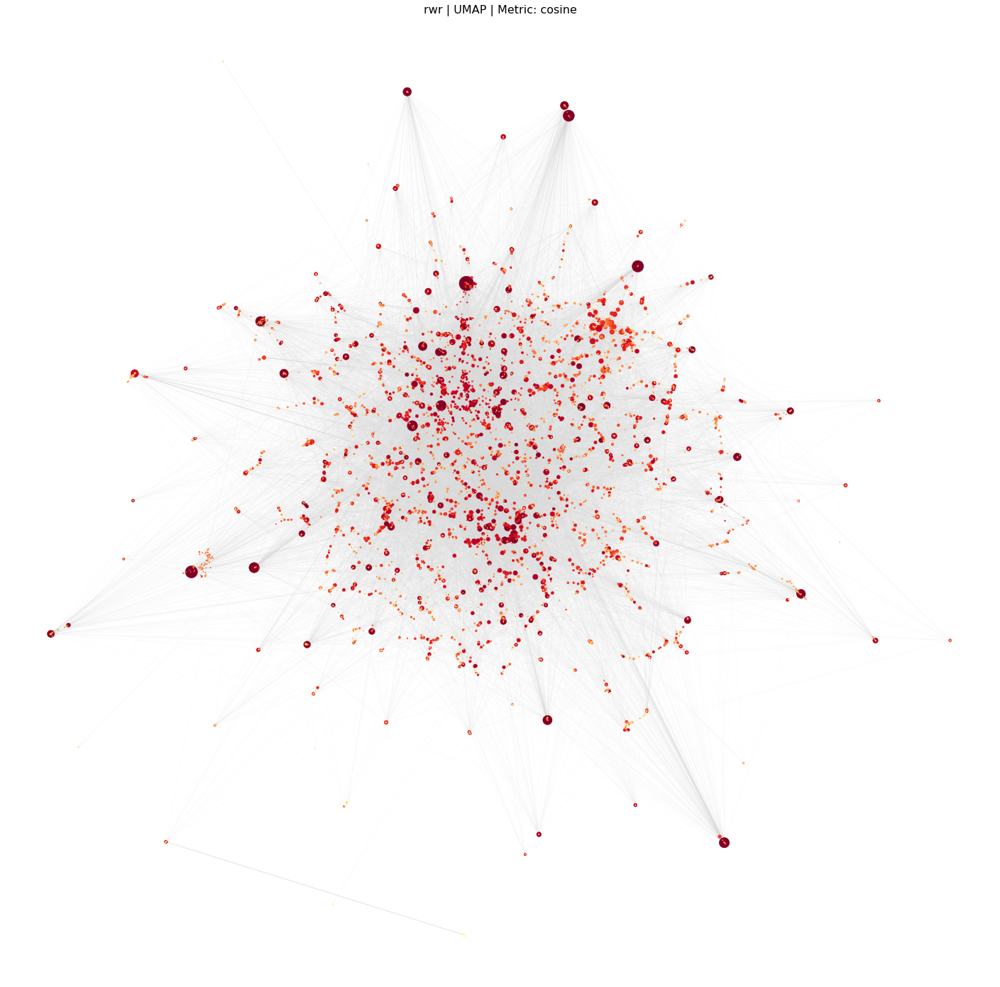

In [31]:
# ----------------------------------------------------        
# Option 1 : networkX PLOT
# ----------------------------------------------------        

plt.figure(figsize=(25,25))
plt.title(feature+' | UMAP | Metric: '+metric, size=16)

nx.draw_networkx_nodes(G, posG_complete_umap_norm, edgecolors = node_edge_col, linewidths = 0.5, node_color=colours, 
                       node_size = size, 
                       alpha = opacity_nodes)
nx.draw_networkx_edges(G, posG_complete_umap_norm, width = edge_width, edge_color = edge_color, alpha = opacity_edges)
plt.box(False)

#plt.savefig('output_plots/2DPortraitumap_'+feature+'_'+metric+'_'+color_method+'_'+str(n_neighbors)+'_'+str(spread)+'_'+str(min_dist)+'_'+organism+'noedges.png')

plt.show()

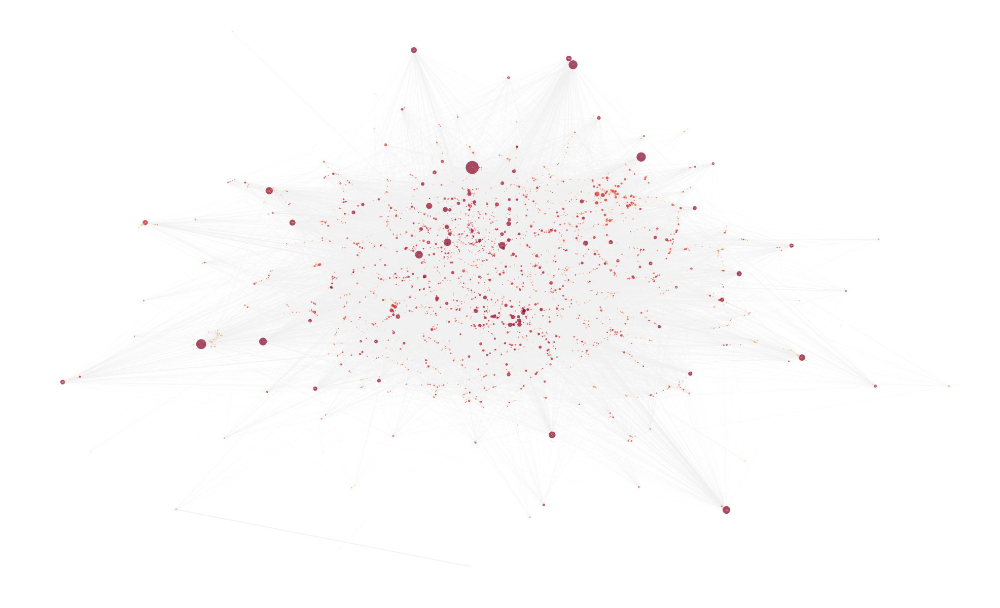

In [35]:
# ----------------------------------------------------        
# Option 2 : Plotly / trace-based PLOT 
# ----------------------------------------------------        

posG_2D = posG_complete_umap_norm

umap2D_nodes = get_trace_nodes_2D(posG_2D, l_features, colours, size3d) 
umap2D_edges = get_trace_edges_2D(G, posG_2D, edge_colordark, opac=0.1) 
umap2D_data = [umap2D_edges, umap2D_nodes]

fig2D = pgo.Figure()
for i in umap2D_data:
    fig2D.add_trace(i)

fig2D.update_layout(
                    margin=dict(l=0, r=0, t=0, b=0),
                    template='plotly_white', 
                    plot_bgcolor='white',
                    font_color="white",
                    showlegend=False, width=1200, height=1200,
                    xaxis = {'showgrid':False,'zeroline':False,},
                    yaxis = {'showgrid':False,'zeroline':False}
                )   

py.iplot(fig2D)

## 3D PORTRAIT

In [80]:
# ----------------------------------------------------        
# please tweek those parameters for your purposes 
# ----------------------------------------------------        

n_neighbors = 10 # balance between local and global structure in the data
spread = 2.0 # defines how dense points are stacked together 
min_dist = 0.1 # defines what counts as neighbour of a point 
metric ='cosine'

In [81]:
%%time 
umap_3D = embed_umap_3D(DM, n_neighbors, spread, min_dist, metric)

CPU times: user 31.1 s, sys: 511 ms, total: 31.6 s
Wall time: 16.4 s


In [82]:
# MAIN (if not all G.nodes)
posG_3Dumap = get_posG_3D(genes, umap_3D)

# This part is added for e.g. Functional Layouts (i.e. where the Distance Matrix does not contain all G.nodes)
# REST (if genes = G.nodes then rest will be ignored / empty)
# get center of data points
xx=[]
yy=[]
zz=[]

for i in posG_3Dumap.values():
    xx.append(i[0])
    yy.append(i[1])
    zz.append(i[2]) 

cx = sum(xx)/len(genes)
cy = sum(yy)/len(genes)
cz = sum(zz)/len(genes)

# generate spherical coordinates for rest genes (without e.g. GO term or Disease Annotation)
indices = arange(0, len(genes_rest))
phi = arccos(1 - 2*indices/len(genes_rest))
theta = pi * (1 + 5**0.5) * indices

xm, ym, zm = max(posG_3Dumap.values())
r = math.sqrt((cx - xm)**2 + (cy - ym)**2 + (cz - zm)**2)
x, y, z = cx+r*cos(theta) * sin(phi),cy+r*sin(theta) * sin(phi), cz+r*cos(phi)

rest_points = []
for i,j,k in zip(x,y,z):
    rest_points.append((i,j,k))

posG_rest = dict(zip(genes_rest, rest_points))

posG_all = {**posG_3Dumap, **posG_rest}
posG_3D_complete_umap = {key:posG_all[key] for key in G.nodes()}

# normalize coordinates 
x_list = []
y_list = []
z_list = []
for k,v in posG_3D_complete_umap.items():
    x_list.append(v[0])
    y_list.append(v[1])
    z_list.append(v[2])
    
xx_norm = sklearn.preprocessing.minmax_scale(x_list, feature_range=(0, 1), axis=0, copy=True)
yy_norm = sklearn.preprocessing.minmax_scale(y_list, feature_range=(0, 1), axis=0, copy=True)
zz_norm = sklearn.preprocessing.minmax_scale(z_list, feature_range=(0, 1), axis=0, copy=True)

posG_3D_complete_umap_norm = dict(zip(list(G.nodes()), zip(xx_norm,yy_norm,zz_norm)))

In [91]:
%%time 
umap_nodes = get_trace_nodes_3D(posG_3D_complete_umap_norm, l_features, colours, 1.5) #size3d)
umap_edges = get_trace_edges_3D(G, posG_3D_complete_umap_norm, edge_colordark, opac=0.4) 

umap_data = [umap_edges, umap_nodes]
#umap_data = [umap_nodes]

CPU times: user 848 ms, sys: 9.11 ms, total: 857 ms
Wall time: 858 ms


# Neighbours: 10
Spread: 2.0
Min. Distance: 0.1


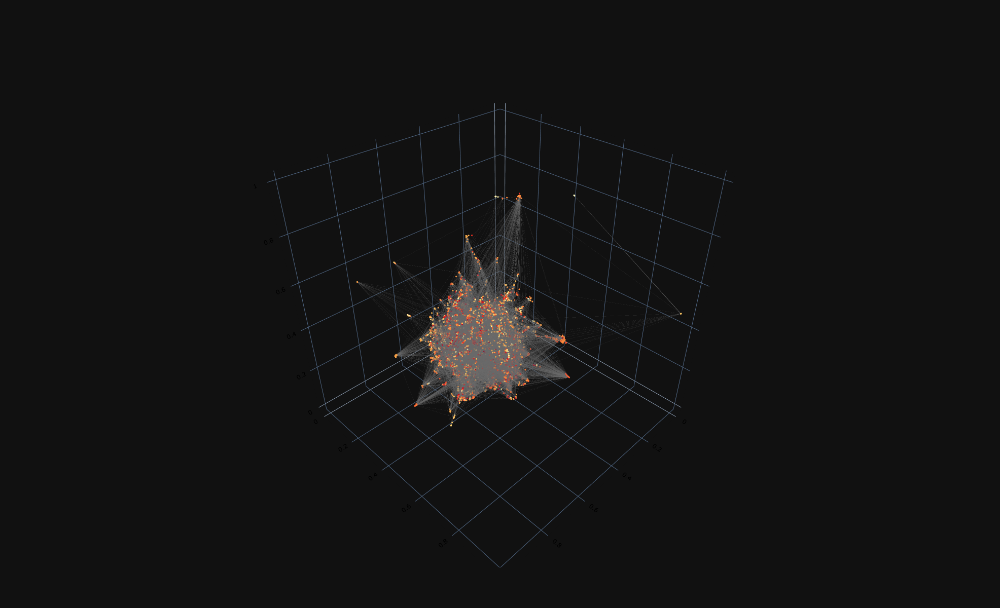

In [92]:
print('# Neighbours:', n_neighbors)
print('Spread:',spread)
print('Min. Distance:', min_dist)


fig = pgo.Figure()
for i in umap_data:
    fig.add_trace(i)

fig.update_layout(template='plotly_dark', showlegend=False, width=1200, height=1200,
                  scene=dict(
                      xaxis_title='',
                      yaxis_title='',
                      zaxis_title='',
                      xaxis=dict(nticks=0,tickfont=dict(
                            color='black')),
                      yaxis=dict(nticks=0,tickfont=dict(
                            color='black')),
                      zaxis=dict(nticks=0,tickfont=dict(
                            color='black')),    
                    dragmode="turntable",
                    #annotations=annotations,
                ))    
py.iplot(fig)

# plotly.offline.plot(fig, filename = 'output_plots/3Dportrait_umap_'+feature+'_'+metric+'_'+color_method+'_'+str(n_neighbors)+'_'+str(spread)+'_'+str(min_dist)+'_'+organism+'.html', auto_open=True)

## LANDSCAPE LAYOUT

+ Define z-parameter

In [95]:
# ----------------------------------------------------        
# Centrality Metrics average 
# ----------------------------------------------------        

z_feat = 'centraverage'
df = feature_df 

d_centr = {}
for i,j in df.iterrows():
    d_centr[i] = round((j[0]+j[1]+j[2]+j[3])/4,2)
    
d_binned = bin_nodes(d_centr)

d_node_bin = {}
for k,v in d_binned.items():
    for each in v:
        d_node_bin[each] = k
        
dict_z = {key:d_node_bin[key] for key in G.nodes()}

z_list = list(dict_z.values())
z_list_norm = sklearn.preprocessing.minmax_scale(z_list, feature_range=(0, 1.0), axis=0, copy=True)

In [97]:
posG_land_umap = {}
cc = 0
for k,v in posG_complete_umap_norm.items():
    posG_land_umap[k] = (v[0],v[1],z_list_norm[cc])
    cc+=1

In [102]:
umap_nodes = get_trace_nodes_3D(posG_land_umap, l_features, colours, 2) #size3d)
umap_edges = get_trace_edges_3D(G, posG_land_umap, edge_colordark)

umap_data = [umap_edges, umap_nodes]
#umap_data = [umap_nodes]

# Neighbors:  10
Spread:  2.0
Min. Distance:  0.1
Metric:  cosine


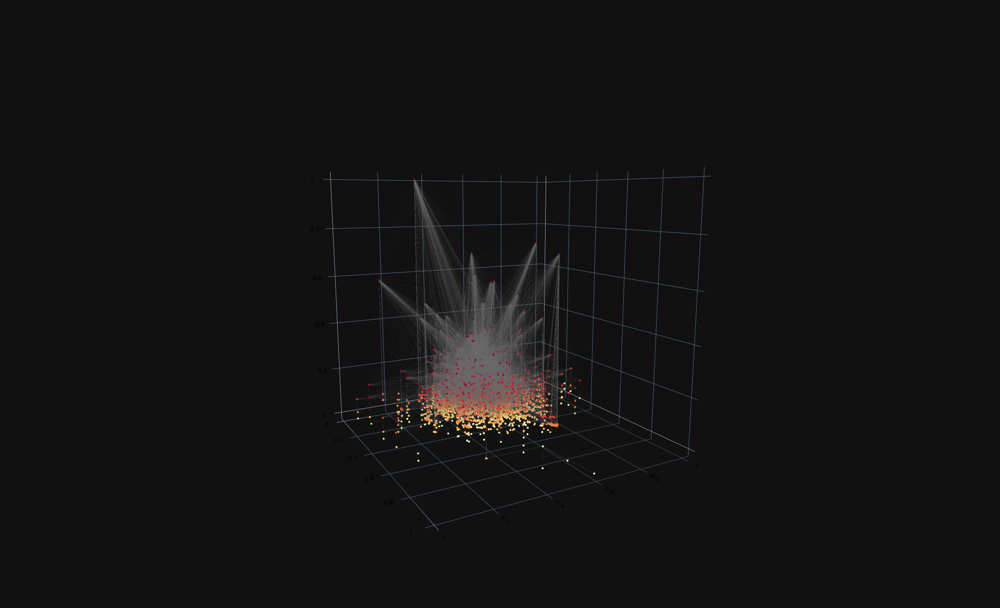

In [103]:
print('# Neighbors: ', n_neighbors)
print('Spread: ', spread)
print('Min. Distance: ', min_dist)
print('Metric: ', metric)


fig = pgo.Figure()
for i in umap_data:
    fig.add_trace(i)

fig.update_layout(template='plotly_dark', showlegend=False, width=1200, height=1200,
                  scene=dict(
                      xaxis_title='',
                      yaxis_title='',
                      zaxis_title='',
                      xaxis=dict(nticks=0,tickfont=dict(
                            color='black')),
                      yaxis=dict(nticks=0,tickfont=dict(
                            color='black')),
                      zaxis=dict(nticks=0,tickfont=dict(
                            color='black')),
                      aspectratio=dict(
                        x=1,
                        y=1,
                        z=1
                    ),
                    camera=dict(
                        center=dict(
                            x=0,
                            y=0,
                            z=0
                        ),
                        eye=dict(
                            x=1.96903462608,
                            y=-1.09022831971,
                            z=0.405345349304
                        ),
                        up=dict(
                            x=0,
                            y=0,
                            z=1
                        )
                    ),
                    dragmode="turntable",
                    #annotations=annotations,
                ))


py.iplot(fig)

# plotly.offline.plot(fig, filename = 'output_plots/Landscapes_umap_'+feature+'_z-'+z_feat+'_'+metric+'_'+color_method+'_'+str(n_neighbors)+'_'+str(spread)+'_'+str(min_dist)+'_'+organism+'.html', auto_open=True)

## SPHERE LAYOUT

+ Define radius-parameter

In [106]:
# ----------------------------------------------------        
# Centrality Metrics average 
# ----------------------------------------------------        

rad_param = 'centraverage'
df = feature_df 

d_centr = {}
for i,j in df.iterrows():
    d_centr[i] = round((j[0]+j[1]+j[2]+j[3])/4,2)

d_binned = bin_nodes(d_centr)

d_node_bin = {}
for k,v in d_binned.items():
    for each in v:
        d_node_bin[each] = k
        
d_param = {key:d_node_bin[key] for key in G.nodes()}

In [107]:
n_neighbors = 10 # balance between local and global structure in the data
spread = 2.0
min_dist = 0.1 # defines how dense points are stacked together 
metric='cosine'

In [108]:
%%time 
umap_sphere = embed_umap_sphere(DM, n_neighbors, spread, min_dist, metric)

CPU times: user 31 s, sys: 591 ms, total: 31.6 s
Wall time: 17.8 s


In [109]:
%%time
posG_3Dsphere = get_posG_sphere(genes, umap_sphere)

CPU times: user 3.87 ms, sys: 687 µs, total: 4.56 ms
Wall time: 3.96 ms


In [110]:
# REST (if genes = G.nodes then rest will be ignored / empty)

# generate spherical coordinates for rest genes (without e.g. GO term or Disease Annotation)
indices = arange(0, len(genes_rest))
phi = arccos(1 - 2*indices/len(genes_rest))
theta = pi * (1 + 5**0.5) * indices

r = 1 # radius for rest genes (e.g. if functional layout)
x, y, z = r*cos(theta) * sin(phi), r*sin(theta) * sin(phi), r*cos(phi)

rest_points = []
for i,j,k in zip(x,y,z):
    rest_points.append((i,j,k))

posG_rest = dict(zip(genes_rest, rest_points))

posG_all = {**posG_3Dsphere, **posG_rest}
posG_complete_sphere = {key:posG_all[key] for key in G.nodes()}

In [111]:
%%time 

posG_sphere_withrad = get_posG_with_sphere_radius(G, posG_complete_sphere, d_param)

CPU times: user 42.1 s, sys: 100 ms, total: 42.2 s
Wall time: 42.3 s


In [112]:
# normalize coordinates 
x_list = []
y_list = []
z_list = []
for k,v in posG_sphere_withrad.items():
    x_list.append(v[0])
    y_list.append(v[1])
    z_list.append(v[2])
    
xx_norm = sklearn.preprocessing.minmax_scale(x_list, feature_range=(0, 1), axis=0, copy=True)
yy_norm = sklearn.preprocessing.minmax_scale(y_list, feature_range=(0, 1), axis=0, copy=True)
zz_norm = sklearn.preprocessing.minmax_scale(z_list, feature_range=(0, 1), axis=0, copy=True)

posG_sphere_withrad_norm = dict(zip(list(G.nodes()), zip(xx_norm,yy_norm,zz_norm)))

In [113]:
sphere_nodes = get_trace_nodes_3D(posG_sphere_withrad_norm, l_features, colours, size3d)
sphere_edges = get_trace_edges_3D(G, posG_sphere_withrad_norm, edge_colordark, 0.1)

#sphere_data = [sphere_edges, sphere_nodes]
sphere_data = [sphere_nodes]

Metric: cosine


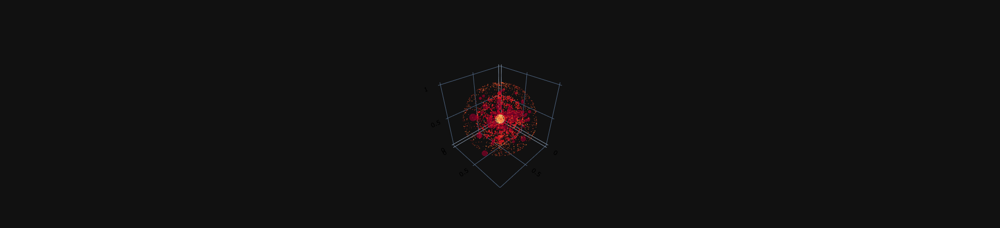

In [114]:
print('Metric:', metric)

fig = pgo.Figure()
for i in sphere_data:
    fig.add_trace(i)

fig.update_layout(template='plotly_dark', showlegend=False, autosize = True,
                  scene=dict(
                      xaxis_title='',
                      yaxis_title='',
                      zaxis_title='',
                      xaxis=dict(nticks=0,tickfont=dict(
                            color='black')),
                      yaxis=dict(nticks=0,tickfont=dict(
                            color='black')),
                      zaxis=dict(nticks=0,tickfont=dict(
                            color='black')),
                    dragmode="turntable",
                    #annotations=annotations,
                ))    
    
py.iplot(fig)

# plotly.offline.plot(fig, filename = 'output_plots/3Dsphere_umap_'+feature+'_'+metric+'_'+color_method+'_'+str(n_neighbors)+'_'+str(spread)+'_'+str(min_dist)+'_'+organism+'_radius'+rad_param+'.html', auto_open=True)